# Imports

In [105]:
#Imports

#Data
import pandas as pd
import numpy as np

#Date
import datetime as dt
from datetime import datetime

#Visualisation
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

#ML
from imblearn.under_sampling import RandomUnderSampler

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler

from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import mean_squared_error, mean_absolute_error

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression

from sklearn.ensemble import GradientBoostingClassifier as xgb
from sklearn.ensemble import GradientBoostingRegressor as xgb_r
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
import tensorflow as tf
from sklearn.neural_network import MLPRegressor
from sklearn import datasets
from sklearn.datasets import make_regression
from sklearn.metrics import confusion_matrix,classification_report

from sklearn.preprocessing import OneHotEncoder

#Notebook
pd.set_option("display.max_rows", None)
mpl.rcParams['agg.path.chunksize'] = 10000
pd.set_option('display.max_columns', None)

# Core

In [99]:
#Core
df=pd.read_csv('xyz_corp_lending_data.csv',sep='\t')

C:\Users\mmoy\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (17,45,53) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [100]:
#Core
df=df.drop(['policy_code','funded_amnt','funded_amnt_inv','out_prncp_inv','total_pymnt_inv','id','member_id','total_rec_prncp','policy_code','installment','pymnt_plan','application_type','next_pymnt_d','title','emp_title','zip_code','grade'],axis=1)

In [101]:
#Core
df=df[nullity[nullity<50].index]

In [102]:
#Core
df['emp_length']=df['emp_length'].str.replace('[A-Za-z\s+<>]+', '').astype('float')
df['term']=df['term'].str.replace('[A-Za-z\s+<>]+', '').astype('float')

# Useful

In [9]:
df.index

RangeIndex(start=0, stop=855969, step=1)

In [10]:
df.columns

Index(['loan_amnt', 'term', 'int_rate', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'desc', 'purpose', 'title', 'zip_code', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths',
       'mths_since_last_delinq', 'mths_since_last_record', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'total_pymnt', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'annual_inc_joint', 'dti_joint', 'verification_status_joint',
       'acc_now_delinq', 'tot_coll_amt', 'tot_cur_bal', 'open_acc_6m',
       'open_il_6m', 'open_il_12m', 'open_il_24m', 'mths_since_rcnt_il',
       'total_bal_il', 'il_util', 'open_rv_12m', 'open_rv_24m', 'max_bal_bc',
       'all_u

In [11]:
df.head()

,loan_amnt,term,int_rate,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,default_ind
0,5000.0,36,10.65,B,B2,NaN,10,RENT,24000.0,Verified,Dec-2011,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-1985,1.0,NaN,NaN,3.0,0.0,13648.0,83.7,9.0,f,0.0,5861.071414,861.07,0.00,0.00,0.00,Jan-2015,171.62,Jan-2016,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
1,2500.0,60,15.27,C,C4,Ryder,1,RENT,30000.0,Source Verified,Dec-2011,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-1999,5.0,NaN,NaN,3.0,0.0,1687.0,9.4,4.0,f,0.0,1008.710000,435.17,0.00,117.08,1.11,Apr-2013,119.66,Sep-2013,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
2,2400.0,36,15.96,C,C5,NaN,10,RENT,12252.0,Not Verified,Dec-2011,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-2001,2.0,NaN,NaN,2.0,0.0,2956.0,98.5,10.0,f,0.0,3003.653644,603.65,0.00,0.00,0.00,Jun-2014,649.91,Jan-2016,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
3,10000.0,36,13.49,C,C1,AIR RESOURCES BOARD,10,RENT,49200.0,Source Verified,Dec-2011,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-1996,1.0,35.0,NaN,10.0,0.0,5598.0,21.0,37.0,f,0.0,12226.302212,2209.33,16.97,0.00,0.00,Jan-2015,357.48,Jan-2015,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
4,3000.0,60,12.69,B,B5,University Medical Group,1,RENT,80000.0,Source Verified,Dec-2011,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-1996,0.0,38.0,NaN,15.0,0.0,27783.0,53.9,38.0,f,766.9,3242.170000,1009.07,0.00,0.00,0.00,Jan-2016,67.79,Jan-2016,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855969 entries, 0 to 855968
Data columns (total 61 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   loan_amnt                    855969 non-null  float64
 1   term                         855969 non-null  int32  
 2   int_rate                     855969 non-null  float64
 3   grade                        855969 non-null  object 
 4   sub_grade                    855969 non-null  object 
 5   emp_title                    806526 non-null  object 
 6   emp_length                   812908 non-null  object 
 7   home_ownership               855969 non-null  object 
 8   annual_inc                   855969 non-null  float64
 9   verification_status          855969 non-null  object 
 10  issue_d                      855969 non-null  object 
 11  desc                         121812 non-null  object 
 12  purpose                      855969 non-null  object 
 13 

In [13]:
df.describe()

,loan_amnt,term,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,mths_since_last_major_derog,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,default_ind
count,855969.000000,855969.000000,855969.000000,8.559690e+05,855969.000000,855969.000000,855969.000000,416157.000000,131184.000000,855969.000000,855969.000000,8.559690e+05,855523.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855913.000000,213139.000000,442.000000,440.000000,855969.000000,7.886560e+05,7.886560e+05,13288.000000,13288.000000,13288.000000,13288.000000,12934.000000,13288.000000,11609.000000,13288.000000,13288.000000,13288.000000,13288.000000,7.886560e+05,13288.000000,13288.000000,13288.000000,855969.000000
mean,14745.571335,43.170764,13.192320,7.507119e+04,18.122165,0.311621,0.680915,34.149943,70.463959,11.542447,0.194537,1.691053e+04,55.019405,25.269269,8284.830230,7653.296336,1755.046221,0.319530,47.089499,4.951227,2225.985295,0.014230,44.101450,107412.163982,18.318477,0.004944,2.254129e+02,1.397662e+05,1.072998,2.945665,0.749323,1.666767,20.833153,36511.541391,71.486993,1.354305,2.945515,5840.443332,61.024526,3.216357e+04,0.947772,1.524232,1.841963,0.054286
std,8425.340005,10.985382,4.368365,6.426447e+04,17.423629,0.857189,0.964033,21.868500,27.827120,5.308094,0.581585,2.222374e+04,23.811585,11.818841,8461.946669,7909.383591,2081.692980,3.609399,413.136043,62.478569,4864.966593,0.133712,22.164907,47987.608637,7.221855,0.077333,1.048945e+04,1.539385e+05,1.206939,3.080330,0.986169,1.685394,26.739237,42492.757796,23.015293,1.483710,2.595313,5108.500262,20.018117,3.769964e+04,1.441667,2.697601,2.975049,0.226581
min,500.000000,36.000000,5.320000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17950.000000,3.050000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,-4.000000,0.000000
25%,8000.000000,36.000000,9.990000,4.500000e+04,11.880000,0.000000,0.000000,15.000000,51.000000,8.000000,0.000000,6.469000e+03,37.600000,17.000000,0.000000,1969.690000,451.270000,0.000000,0.000000,0.000000,285.420000,0.000000,27.000000,75000.250000,13.187500,0.000000,0.000000e+00,2.987000e+04,0.000000,1.000000,0.000000,0.000000,6.000000,10390.250000,58.500000,0.000000,1.000000,2405.000000,47.900000,1.400000e+04,0.000000,0.000000,0.000000,0.000000
50%,13000.000000,36.000000,12.990000,6.500000e+04,17.610000,0.000000,0.000000,31.000000,70.000000,11.000000,0.000000,1.190300e+04,55.900000,24.000000,6290.250000,4976.160000,1076.910000,0.000000,0.000000,0.000000,468.820000,0.000000,44.000000,100000.000000,17.735000,0.000000,0.000000e+00,8.100850e+04,1.000000,2.000000,0.000000,1.000000,12.000000,24959.500000,75.000000,1.000000,2.000000,4485.500000,62.100000,2.380000e+04,0.000000,0.000000,2.000000,0.000000
75%,20000.000000,60.000000,15.990000,9.000000e+04,23.900000,0.000000,1.000000,50.000000,92.000000,14.000000,0.000000,2.085700e+04,73.500000,32.000000,13528.800000,10744.803649,2233.980000,0.000000,0.000000,0.000000,849.160000,0.000000,61.000000,130750.000000,22.650000,0.000000,0.000000e+00,2.087032e+05,2.000000,4.000000,1.000000,2.000000,23.000000,47493.000000,87.500000,2.000000,4.000000,7701.250000,75.300000,3.990000e+04,1.000000,2.000000,3.000000,0.000000
max,35000.000000,60.000000,28.990000,9.500000e+06,9999.000000,39.000000,8.000000,188.000000,129.000

In [14]:
df.shape

(855969, 61)

In [92]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
nullity

tot_coll_amt                  7.863953
tot_cur_bal                   7.863953
total_rev_hi_lim              7.863953
emp_title                     5.776261
emp_length                    5.030673
last_pymnt_d                  1.035318
revol_util                    0.052105
collections_12_mths_ex_med    0.006542
last_credit_pull_d            0.005841
title                         0.003855
acc_now_delinq                0.000000
zip_code                      0.000000
purpose                       0.000000
issue_d                       0.000000
default_ind                   0.000000
verification_status           0.000000
annual_inc                    0.000000
home_ownership                0.000000
sub_grade                     0.000000
grade                         0.000000
loan_amnt                     0.000000
dti                           0.000000
total_acc                     0.000000
last_pymnt_amnt               0.000000
collection_recovery_fee       0.000000
recoveries               

# History

In [15]:
#Core
df=pd.read_csv('xyz_corp_lending_data.csv',sep='\t')

C:\Users\mmoy\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (17,45,53) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [16]:
df.index

RangeIndex(start=0, stop=855969, step=1)

In [17]:
df.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'pymnt_plan', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq', 'mths_since_last_record',
       'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'verification_status_joint', 'acc_now_delinq', 'tot_col

In [18]:
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,pymnt_plan,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,default_ind
0,1077501,1296599,5000.0,5000.0,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-2011,n,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-1985,1.0,NaN,NaN,3.0,0.0,13648.0,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-2015,171.62,NaN,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
1,1077430,1314167,2500.0,2500.0,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-2011,n,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-1999,5.0,NaN,NaN,3.0,0.0,1687.0,9.4,4.0,f,0.0,0.0,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-2013,119.66,NaN,Sep-2013,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
2,1077175,1313524,2400.0,2400.0,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-2011,n,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-2001,2.0,NaN,NaN,2.0,0.0,2956.0,98.5,10.0,f,0.0,0.0,3003.653644,3003.65,2400.00,603.65,0.00,0.00,0.00,Jun-2014,649.91,NaN,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
3,1076863,1277178,10000.0,10000.0,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-2011,n,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-1996,1.0,35.0,NaN,10.0,0.0,5598.0,21.0,37.0,f,0.0,0.0,12226.302212,12226.30,10000.00,2209.33,16.97,0.00,0.00,Jan-2015,357.48,NaN,Jan-2015,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
4,1075358,1311748,3000.0,3000.0,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,RENT,80000.0,Source Verified,Dec-2011,n,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-1996,0.0,38.0,NaN,15.0,0.0,27783.0,53.9,38.0,f,766.9,766.9,3242.170000,3242.17,2233.10,1009.07,0.00,0.00,0.00,Jan-2016,67.79,Feb-2016,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855969 entries, 0 to 855968
Data columns (total 73 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           855969 non-null  int64  
 1   member_id                    855969 non-null  int64  
 2   loan_amnt                    855969 non-null  float64
 3   funded_amnt                  855969 non-null  float64
 4   funded_amnt_inv              855969 non-null  float64
 5   term                         855969 non-null  object 
 6   int_rate                     855969 non-null  float64
 7   installment                  855969 non-null  float64
 8   grade                        855969 non-null  object 
 9   sub_grade                    855969 non-null  object 
 10  emp_title                    806526 non-null  object 
 11  emp_length                   812908 non-null  object 
 12  home_ownership               855969 non-null  object 
 13 

In [20]:
df.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,default_ind
count,8.559690e+05,8.559690e+05,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,8.559690e+05,855969.000000,855969.000000,855969.000000,416157.000000,131184.000000,855969.000000,855969.000000,8.559690e+05,855523.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.00000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855913.000000,213139.000000,855969.0,442.000000,440.000000,855969.000000,7.886560e+05,7.886560e+05,13288.000000,13288.000000,13288.000000,13288.000000,12934.000000,13288.000000,11609.000000,13288.000000,13288.000000,13288.000000,13288.000000,7.886560e+05,13288.000000,13288.000000,13288.000000,855969.000000
mean,3.224073e+07,3.476269e+07,14745.571335,14732.378305,14700.061226,13.192320,436.238072,7.507119e+04,18.122165,0.311621,0.680915,34.149943,70.463959,11.542447,0.194537,1.691053e+04,55.019405,25.269269,8284.830230,8281.449347,7653.296336,7622.22052,5850.841088,1755.046221,0.319530,47.089499,4.951227,2225.985295,0.014230,44.101450,1.0,107412.163982,18.318477,0.004944,2.254129e+02,1.397662e+05,1.072998,2.945665,0.749323,1.666767,20.833153,36511.541391,71.486993,1.354305,2.945515,5840.443332,61.024526,3.216357e+04,0.947772,1.524232,1.841963,0.054286
std,2.271969e+07,2.399418e+07,8425.340005,8419.471653,8425.805478,4.368365,243.726876,6.426447e+04,17.423629,0.857189,0.964033,21.868500,27.827120,5.308094,0.581585,2.222374e+04,23.811585,11.818841,8461.946669,8458.496422,7909.383591,7885.15640,6676.410888,2081.692980,3.609399,413.136043,62.478569,4864.966593,0.133712,22.164907,0.0,47987.608637,7.221855,0.077333,1.048945e+04,1.539385e+05,1.206939,3.080330,0.986169,1.685394,26.739237,42492.757796,23.015293,1.483710,2.595313,5108.500262,20.018117,3.769964e+04,1.441667,2.697601,2.975049,0.226581
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,5.320000,15.690000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,2.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,17950.000000,3.050000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,-4.000000,0.000000
25%,9.067986e+06,1.079273e+07,8000.000000,8000.000000,8000.000000,9.990000,260.550000,4.500000e+04,11.880000,0.000000,0.000000,15.000000,51.000000,8.000000,0.000000,6.469000e+03,37.600000,17.000000,0.000000,0.000000,1969.690000,1960.12000,1239.950000,451.270000,0.000000,0.000000,0.000000,285.420000,0.000000,27.000000,1.0,75000.250000,13.187500,0.000000,0.000000e+00,2.987000e+04,0.000000,1.000000,0.000000,0.000000,6.000000,10390.250000,58.500000,0.000000,1.000000,2405.000000,47.900000,1.400000e+04,0.000000,0.000000,0.000000,0.000000
50%,3.431355e+07,3.697532e+07,13000.000000,13000.000000,13000.000000,12.990000,382.550000,6.500000e+04,17.610000,0.000000,0.000000,31.000000,70.000000,11.000000,0.000000,1.190300e+04,55.900000,24.000000,6290.250000,6287.650000,4976.160000,4948.25000,3286.890000,1076.910000,0.000000,0.000000,0.000000,468.820000,0.000000,44.000000,1.0,100000.000000,17.735000,0.000000,0.000000e+00,8.100850e+04,1.000000,2.000000,0.000000,1.000000,12.000000,24959.500000,75.000000,1.0

In [21]:
df.shape

(855969, 73)

In [22]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)

In [23]:
nullity

dti_joint                    99.948596
verification_status_joint    99.948363
annual_inc_joint             99.948363
il_util                      98.643759
mths_since_rcnt_il           98.488964
                               ...    
pub_rec                       0.000000
open_acc                      0.000000
inq_last_6mths                0.000000
earliest_cr_line              0.000000
id                            0.000000
Length: 73, dtype: float64

In [24]:
df['policy_code'].value_counts()

1.0    855969
Name: policy_code, dtype: int64

In [25]:
#Core
df=df[nullity[nullity<50].index]

In [26]:
#Core
df=df.drop('policy_code',axis=1)

In [27]:
df.shape

(855969, 51)

In [28]:
correl=df.corr()
#correl

<AxesSubplot:>

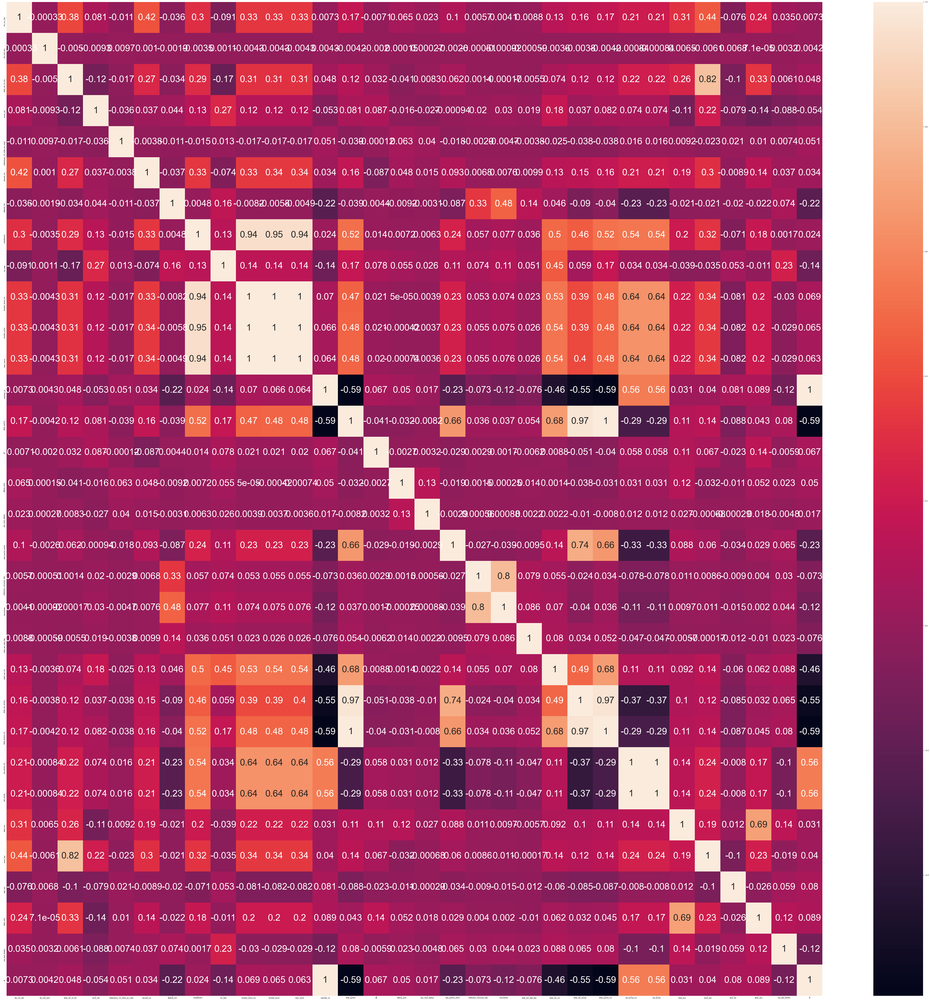

In [29]:
fig, ax = plt.subplots(figsize=(100,100))
sns.set(font_scale = 1)
sns.heatmap(df.corr(), 
        xticklabels=df.corr().columns,
        yticklabels=df.corr().columns,annot=True,ax=ax,annot_kws={"fontsize":50})

In [30]:
#Core
df=df.drop(['funded_amnt','funded_amnt_inv','out_prncp_inv','total_pymnt_inv','id','member_id','total_rec_prncp'],axis=1)

<AxesSubplot:>

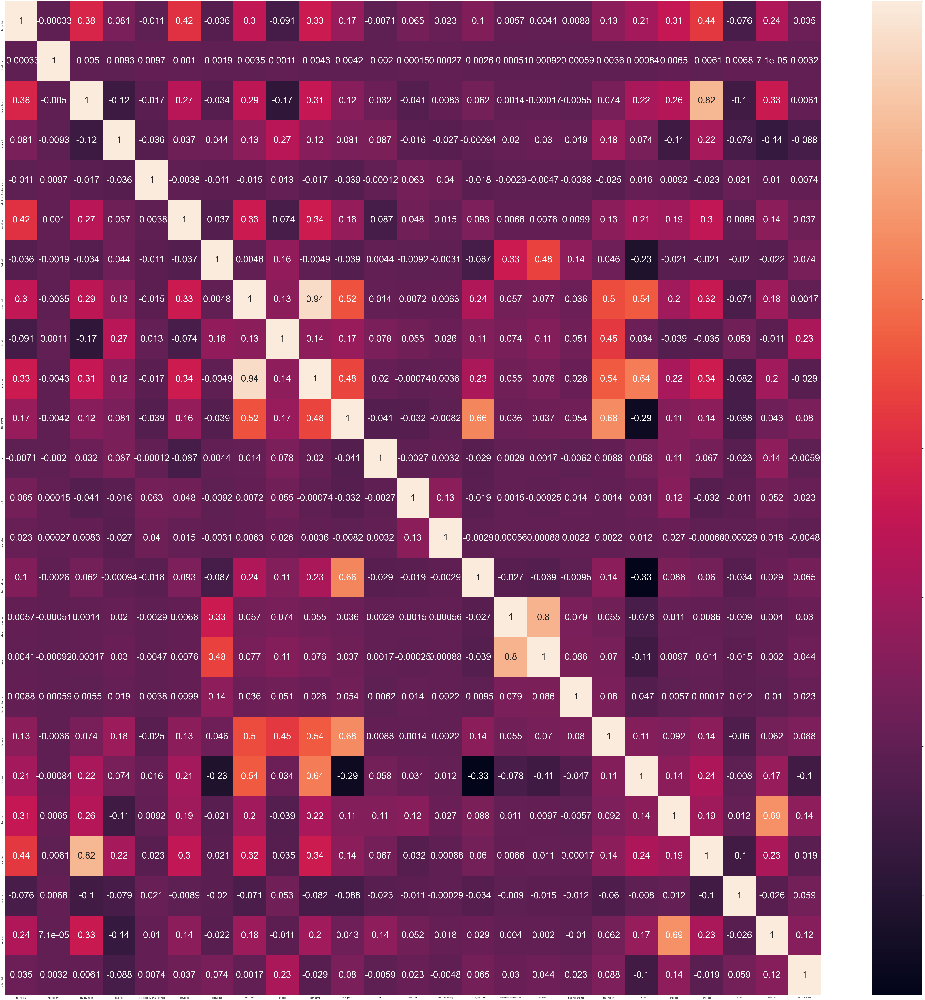

In [31]:
fig, ax = plt.subplots(figsize=(100,100))
sns.set(font_scale = 0.001)
sns.heatmap(df.corr(), 
        xticklabels=df.corr().columns,
        yticklabels=df.corr().columns,annot=True,ax=ax,annot_kws={"fontsize":50})

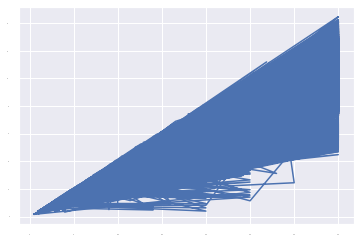

In [32]:
fig,ax = plt.subplots(1)

# create some x data and some integers for the y axis
x = df['loan_amnt']
y = df['installment']

# plot the data
ax.plot(x,y)

In [33]:
comp_df=df[['loan_amnt','installment']]

In [34]:
comp_df['division']=comp_df['loan_amnt']/comp_df['installment']

<ipython-input-34-f1d02da25db7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  comp_df['division']=comp_df['loan_amnt']/comp_df['installment']


In [35]:
comp_df

,loan_amnt,installment,division
0,5000.0,162.87,30.699331
1,2500.0,59.83,41.785058
2,2400.0,84.33,28.459623
3,10000.0,339.31,29.471575
4,3000.0,67.79,44.254315
...,...,...,...
855964,10000.0,332.10,30.111412
855965,24000.0,797.03,30.111790
855966,13000.0,316.07,41.130129
855967,12000.0,317.86,37.752470


In [36]:
comp_df['division'].describe()

count    855969.000000
mean         33.554583
std           5.855275
min          23.865472
25%          29.600395
50%          31.368030
75%          37.751940
max         504.286435
Name: division, dtype: float64

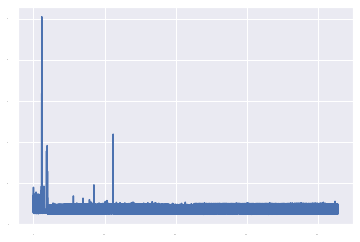

In [37]:
plt.plot(comp_df['division'])

C:\Users\mmoy\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='division', ylabel='Density'>

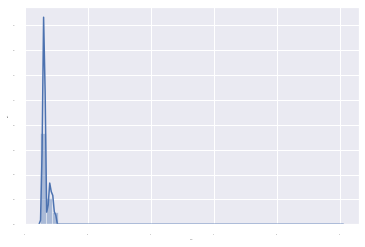

In [38]:
sns.distplot(comp_df['division'])

In [39]:
#Core
df=df.drop('installment',axis=1)

In [40]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
nullity

next_pymnt_d                  29.553757
tot_cur_bal                    7.863953
tot_coll_amt                   7.863953
total_rev_hi_lim               7.863953
emp_title                      5.776261
emp_length                     5.030673
last_pymnt_d                   1.035318
revol_util                     0.052105
collections_12_mths_ex_med     0.006542
last_credit_pull_d             0.005841
title                          0.003855
int_rate                       0.000000
purpose                        0.000000
pymnt_plan                     0.000000
issue_d                        0.000000
verification_status            0.000000
annual_inc                     0.000000
home_ownership                 0.000000
default_ind                    0.000000
sub_grade                      0.000000
grade                          0.000000
earliest_cr_line               0.000000
inq_last_6mths                 0.000000
recoveries                     0.000000
open_acc                       0.000000


In [41]:
correl=df.corr()
correl

,tot_cur_bal,tot_coll_amt,total_rev_hi_lim,revol_util,collections_12_mths_ex_med,annual_inc,default_ind,int_rate,loan_amnt,total_pymnt,dti,delinq_2yrs,acc_now_delinq,last_pymnt_amnt,collection_recovery_fee,recoveries,total_rec_late_fee,total_rec_int,out_prncp,total_acc,revol_bal,pub_rec,open_acc,inq_last_6mths
tot_cur_bal,1.000000,-0.000331,0.384867,0.080583,-0.010622,0.422618,-0.036335,-0.091430,0.329130,0.169289,-0.007133,0.064618,0.022804,0.103113,0.005704,0.004063,0.008831,0.134022,0.207565,0.311268,0.443059,-0.075956,0.244465,0.034806
tot_coll_amt,-0.000331,1.000000,-0.005025,-0.009252,0.009686,0.001005,-0.001921,0.001129,-0.004272,-0.004203,-0.001995,0.000154,0.000267,-0.002568,-0.000514,-0.000919,-0.000592,-0.003562,-0.000840,0.006463,-0.006117,0.006816,0.000071,0.003181
total_rev_hi_lim,0.384867,-0.005025,1.000000,-0.117724,-0.016808,0.271059,-0.033620,-0.165533,0.312072,0.120593,0.032430,-0.040575,0.008254,0.062068,0.001399,-0.000171,-0.005545,0.073855,0.221319,0.255391,0.820800,-0.100227,0.325179,0.006089
revol_util,0.080583,-0.009252,-0.117724,1.000000,-0.035707,0.036753,0.044497,0.271687,0.119635,0.080945,0.086649,-0.016299,-0.027270,-0.000939,0.019880,0.029601,0.019445,0.183754,0.074353,-0.114616,0.217785,-0.079050,-0.144959,-0.088353
collections_12_mths_ex_med,-0.010622,0.009686,-0.016808,-0.035707,1.000000,-0.003789,-0.010650,0.012841,-0.017042,-0.038618,-0.000117,0.063019,0.040197,-0.017771,-0.002866,-0.004684,-0.003835,-0.024670,0.015653,0.009181,-0.022552,0.020874,0.009998,0.007364
annual_inc,0.422618,0.001005,0.271059,0.036753,-0.003789,1.000000,-0.037066,-0.073825,0.335209,0.163226,-0.086821,0.047749,0.014877,0.092662,0.006805,0.007613,0.009864,0.130367,0.211549,0.188651,0.298569,-0.008909,0.139429,0.037251
default_ind,-0.036335,-0.001921,-0.033620,0.044497,-0.010650,-0.037066,1.000000,0.155037,-0.004907,-0.039220,0.004429,-0.009186,-0.003116,-0.087217,0.330764,0.475738,0.140760,0.046050,-0.225960,-0.021087,-0.020696,-0.019607,-0.021698,0.074407
int_rate,-0.091430,0.001129,-0.165533,0.271687,0.012841,-0.073825,0.155037,1.000000,0.142966,0.173387,0.078454,0.055400,0.026476,0.107346,0.074360,0.110848,0.050743,0.446517,0.033933,-0.039482,-0.035344,0.052596,-0.011091,0.231705
loan_amnt,0.329130,-0.004272,0.312072,0.119635,-0.017042,0.335209,-0.004907,0.142966,1.000000,0.479612,0.020189,-0.000739,0.003572,0.233596,0.055135,0.075513,0.025966,0.537586,0.639784,0.222084,0.337489,-0.082199,0.198926,-0.028928
total_pymnt,0.169289,-0.004203,0.120593,0.080945,-0.038618,0.163226,-0.039220,0.173387,0.479612,1.000000,-0.040537,-0.031777,-0.008220,0.662738,0.035844,0.037201,0.054403,0.679127,-0.289173,0.110169,0.139161,-0.087933,0.043452,0.080476


In [42]:
df.head(200)

,next_pymnt_d,tot_cur_bal,tot_coll_amt,total_rev_hi_lim,emp_title,emp_length,last_pymnt_d,revol_util,collections_12_mths_ex_med,last_credit_pull_d,title,purpose,pymnt_plan,issue_d,verification_status,annual_inc,home_ownership,default_ind,sub_grade,grade,int_rate,term,addr_state,loan_amnt,zip_code,total_pymnt,dti,delinq_2yrs,acc_now_delinq,application_type,last_pymnt_amnt,collection_recovery_fee,recoveries,total_rec_late_fee,total_rec_int,out_prncp,initial_list_status,total_acc,revol_bal,pub_rec,open_acc,inq_last_6mths,earliest_cr_line
0,NaN,NaN,NaN,NaN,NaN,10+ years,Jan-2015,83.7,0.0,Jan-2016,Computer,credit_card,n,Dec-2011,Verified,24000.0,RENT,0,B2,B,10.65,36 months,AZ,5000.0,860xx,5861.071414,27.65,0.0,0.0,INDIVIDUAL,171.62,0.00,0.00,0.00,861.07,0.0,f,9.0,13648.0,0.0,3.0,1.0,Jan-1985
1,NaN,NaN,NaN,NaN,Ryder,< 1 year,Apr-2013,9.4,0.0,Sep-2013,bike,car,n,Dec-2011,Source Verified,30000.0,RENT,1,C4,C,15.27,60 months,GA,2500.0,309xx,1008.710000,1.00,0.0,0.0,INDIVIDUAL,119.66,1.11,117.08,0.00,435.17,0.0,f,4.0,1687.0,0.0,3.0,5.0,Apr-1999
2,NaN,NaN,NaN,NaN,NaN,10+ years,Jun-2014,98.5,0.0,Jan-2016,real estate business,small_business,n,Dec-2011,Not Verified,12252.0,RENT,0,C5,C,15.96,36 months,IL,2400.0,606xx,3003.653644,8.72,0.0,0.0,INDIVIDUAL,649.91,0.00,0.00,0.00,603.65,0.0,f,10.0,2956.0,0.0,2.0,2.0,Nov-2001
3,NaN,NaN,NaN,NaN,AIR RESOURCES BOARD,10+ years,Jan-2015,21.0,0.0,Jan-2015,personel,other,n,Dec-2011,Source Verified,49200.0,RENT,0,C1,C,13.49,36 months,CA,10000.0,917xx,12226.302212,20.00,0.0,0.0,INDIVIDUAL,357.48,0.00,0.00,16.97,2209.33,0.0,f,37.0,5598.0,0.0,10.0,1.0,Feb-1996
4,Feb-2016,NaN,NaN,NaN,University Medical Group,1 year,Jan-2016,53.9,0.0,Jan-2016,Personal,other,n,Dec-2011,Source Verified,80000.0,RENT,0,B5,B,12.69,60 months,OR,3000.0,972xx,3242.170000,17.94,0.0,0.0,INDIVIDUAL,67.79,0.00,0.00,0.00,1009.07,766.9,f,38.0,27783.0,0.0,15.0,0.0,Jan-1996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,NaN,NaN,NaN,NaN,Corning Inc.,8 years,Oct-2012,86.2,0.0,Feb-2013,Debt Consolidation Loan,other,n,Dec-2011,Not Verified,70000.0,MORTGAGE,1,C2,C,14.27,36 months,NY,12000.0,148xx,4241.160000,8.40,0.0,0.0,INDIVIDUAL,411.71,5.32,543.42,0.00,1163.48,0.0,f,12.0,11546.0,0.0,7.0,1.0,Aug-2005
196,NaN,NaN,NaN,NaN,UPS,10+ years,Sep-2014,89.1,0.0,Aug-2014,Debt Consolidation Loan,debt_consolidation,n,Dec-2011,Verified,100000.0,MORTGAGE,0,B3,B,11.71,36 months,RI,25000.0,028xx,29277.573837,6.88,0.0,0.0,INDIVIDUAL,1122.55,0.00,0.00,0.00,4277.57,0.0,f,18.0,21128.0,0.0,8.0,1.0,Dec-1986
197,NaN,NaN,NaN,NaN,Gilbert Express,5 years,Jan-2015,55.4,0.0,Sep-2015,Debt Consolidation Loan,debt_consolidation,n,Dec-2011,Source Verified,50000.0,RENT,0,B5,B,12.69,36 months,NY,9000.0,115xx,10867.209977,17.81,0.0,0.0,INDIVIDUAL,306.11,0.00,0.00,0.00,1867.21,0.0,f,21.0,12752.0,0.0,13.0,1.0,Dec-2001
198,NaN,NaN,NaN,NaN,Talbert House,4 years,Jan-2015,58.7,0.0,Jan-2016,Debt Consolidation Loan,debt_consolidation,n,Dec-2011,Not Verified,35000.0,RENT,0,B2,B,10.65,36 months,OH,13250.0,450xx,15535.931858,24.93,0.0,0.0,INDIVIDUAL,437.68,0.00,0.00,0.00,2285.93,0.0,f,25.0,13392.0,0.0,11.0,2.0,Oct-2002


In [43]:
#df.to_csv('attempt1')

In [44]:
col=df.columns
for col in df[col]:
    print(col, ' ' ,df[[col]].value_counts())

next_pymnt_d   next_pymnt_d
Feb-2016        534094
Jan-2016         68838
Mar-2016            66
dtype: int64
tot_cur_bal   tot_cur_bal
0.0            121
22396.0         21
27316.0         20
34574.0         20
29232.0         20
              ... 
263542.0         1
263541.0         1
263538.0         1
263537.0         1
186014.0         1
Length: 322286, dtype: int64
tot_coll_amt   tot_coll_amt
0.0             677062
50.0              1688
100.0             1307
75.0               998
200.0              688
                 ...  
8707.0               1
8706.0               1
3528.0               1
3529.0               1
9152545.0            1
Length: 10138, dtype: int64
total_rev_hi_lim   total_rev_hi_lim
15000.0             2554
10000.0             2525
12000.0             2519
13000.0             2507
14500.0             2502
                    ... 
52847.0                1
52829.0                1
52821.0                1
52820.0                1
43210.0                1
Length

last_pymnt_amnt   last_pymnt_amnt
0.00               8867
327.34             2053
318.79             1767
312.86             1437
392.81             1374
                   ... 
7849.40               1
7849.37               1
7849.27               1
7849.24               1
4301.46               1
Length: 230321, dtype: int64
collection_recovery_fee   collection_recovery_fee
0.0000                     832934
2.0000                         15
4.5200                         11
2.5200                         11
1.8800                         11
                            ...  
177.8382                        1
177.8508                        1
177.9322                        1
177.9498                        1
33.5991                         1
Length: 20529, dtype: int64
recoveries   recoveries
0.00          831782
200.00            10
14.28              9
11.70              9
10.00              8
               ...  
1917.87            1
1918.14            1
1918.74            1
1918.82 

In [45]:
#To Explore

#pymnt_plan 
#application_type

In [46]:
df['pymnt_plan'].value_counts()

n    855964
y         5
Name: pymnt_plan, dtype: int64

In [47]:
df['application_type'].value_counts()

INDIVIDUAL    855527
JOINT            442
Name: application_type, dtype: int64

In [48]:
df['default_ind'].value_counts()

0    809502
1     46467
Name: default_ind, dtype: int64

In [49]:
df['next_pymnt_d'].value_counts()

Feb-2016    534094
Jan-2016     68838
Mar-2016        66
Name: next_pymnt_d, dtype: int64

In [50]:
#Core
df=df.drop(['pymnt_plan','application_type','next_pymnt_d'],axis=1)

In [51]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855969 entries, 0 to 855968
Data columns (total 40 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   tot_cur_bal                 788656 non-null  float64
 1   tot_coll_amt                788656 non-null  float64
 2   total_rev_hi_lim            788656 non-null  float64
 3   emp_title                   806526 non-null  object 
 4   emp_length                  812908 non-null  object 
 5   last_pymnt_d                847107 non-null  object 
 6   revol_util                  855523 non-null  float64
 7   collections_12_mths_ex_med  855913 non-null  float64
 8   last_credit_pull_d          855919 non-null  object 
 9   title                       855936 non-null  object 
 10  purpose                     855969 non-null  object 
 11  issue_d                     855969 non-null  object 
 12  verification_status         855969 non-null  object 
 13  annual_inc    

In [52]:
#Types of Attributes that are not floats/integers

#categorical

#empt_title DROPPED
#emp_length CHANGED
#title DROPPED
#purpose
#verification_status
#pymnt_plan
#home_ownership
#sub_grade
#grade
#term CHANGED
#addr_state
#zip_code DROPPED
#application_type
#initial_list_status


#date

#next_pymnt_d DROPPED
#last_pymnt_d
#last_credit_pull_d
#issue_d IMPORTANT FOR TR/TS SPLIT DONT TOUCH
#earliest_cr_line

#y
#default_ind

In [53]:
df['emp_length'].value_counts()

10+ years    282090
2 years       75986
< 1 year      67597
3 years       67392
1 year        54855
5 years       53812
4 years       50643
7 years       43204
8 years       42421
6 years       41446
9 years       33462
Name: emp_length, dtype: int64

In [54]:
df['term'].value_counts()

 36 months    600221
 60 months    255748
Name: term, dtype: int64

In [57]:
#Core
df['emp_length']=df['emp_length'].str.replace('[A-Za-z\s+<>]+', '')
df['term']=df['term'].str.replace('[A-Za-z\s+<>]+', '').astype('int')

In [56]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
nullity

tot_cur_bal                   7.863953
tot_coll_amt                  7.863953
total_rev_hi_lim              7.863953
emp_title                     5.776261
emp_length                    5.030673
last_pymnt_d                  1.035318
revol_util                    0.052105
collections_12_mths_ex_med    0.006542
last_credit_pull_d            0.005841
title                         0.003855
inq_last_6mths                0.000000
purpose                       0.000000
issue_d                       0.000000
verification_status           0.000000
annual_inc                    0.000000
home_ownership                0.000000
default_ind                   0.000000
sub_grade                     0.000000
grade                         0.000000
int_rate                      0.000000
earliest_cr_line              0.000000
addr_state                    0.000000
total_rec_late_fee            0.000000
open_acc                      0.000000
pub_rec                       0.000000
revol_bal                

In [107]:
df['title'].value_counts()

Debt consolidation                                                                  398089
Credit card refinancing                                                             159228
Home improvement                                                                     38633
Other                                                                                30522
Debt Consolidation                                                                   15469
Major purchase                                                                       11519
Medical expenses                                                                      6408
Business                                                                              6325
Car financing                                                                         5372
Consolidation                                                                         5266
debt consolidation                                                                    4718

In [106]:
df['emp_title'].value_counts()

Teacher                                                                           12965
Manager                                                                           10821
Registered Nurse                                                                   5341
RN                                                                                 5182
Owner                                                                              5157
Supervisor                                                                         4792
Sales                                                                              4051
Project Manager                                                                    3856
Driver                                                                             3417
Office Manager                                                                     3404
Director                                                                           3067
General Manager                 

In [ ]:
#Core
df=df.drop(['title','emp_title'],axis=1)

In [109]:
df['zip_code'].value_counts()

945xx    9466
750xx    9111
112xx    8894
606xx    8370
300xx    7820
100xx    7348
070xx    7143
331xx    7139
900xx    7022
770xx    6657
891xx    6193
917xx    6140
330xx    6021
117xx    5885
104xx    5732
921xx    5463
852xx    5257
926xx    5227
913xx    4989
925xx    4752
113xx    4633
334xx    4573
481xx    4491
601xx    4446
021xx    4389
600xx    4387
604xx    4381
080xx    4377
956xx    4191
980xx    4145
920xx    4145
853xx    4099
941xx    4074
928xx    4042
301xx    4024
802xx    4011
760xx    3982
773xx    3958
201xx    3875
207xx    3819
774xx    3799
850xx    3787
951xx    3665
902xx    3598
088xx    3570
923xx    3552
480xx    3547
212xx    3514
782xx    3440
554xx    3390
553xx    3379
275xx    3364
800xx    3339
114xx    3326
333xx    3292
752xx    3250
940xx    3194
605xx    3178
787xx    3163
303xx    3136
953xx    3127
786xx    3102
327xx    3096
840xx    3048
328xx    3034
958xx    3032
775xx    3000
967xx    2981
191xx    2955
441xx    2921
890xx    2917
483xx 

In [ ]:
#Core
df.drop('zip_code',axis=1)

In [110]:
df['addr_state'].value_counts()

CA    125172
NY     71114
TX     68708
FL     58639
IL     34379
NJ     32061
PA     30250
OH     28651
GA     28043
VA     25234
NC     23787
MI     22175
MD     20209
MA     19835
AZ     19693
WA     18816
CO     18211
MN     15424
MO     13743
IN     13348
CT     13042
TN     12392
NV     11972
WI     11199
AL     10732
OR     10562
SC     10302
LA     10186
KY      8299
OK      7759
KS      7693
AR      6399
UT      6055
NM      4757
HI      4380
WV      4247
NH      4156
RI      3753
MS      3653
MT      2466
DE      2402
DC      2382
AK      2134
WY      1974
VT      1753
SD      1745
NE      1124
ME       491
ND       452
ID         9
IA         7
Name: addr_state, dtype: int64

In [111]:
df['grade'].value_counts()

B    247998
C    236855
A    145665
D    132802
E     66448
F     21328
G      4873
Name: grade, dtype: int64

In [112]:
df['sub_grade'].value_counts()

B3    54958
B4    54116
C1    51588
C2    50457
C3    48337
B2    47589
B5    47333
C4    46941
B1    44002
A5    43957
C5    39532
D1    34667
A4    33991
D2    28385
D3    25289
D4    24253
A3    23095
A1    22516
A2    22106
D5    20208
E1    17230
E2    15994
E3    13294
E4    11011
E5     8919
F1     6702
F2     4979
F3     4099
F4     3168
F5     2380
G1     1698
G2     1259
G3      877
G4      570
G5      469
Name: sub_grade, dtype: int64

In [121]:
df[df['grade']=='G']['sub_grade'].value_counts()

G1    1698
G2    1259
G3     877
G4     570
G5     469
Name: sub_grade, dtype: int64

In [ ]:
#Core
df.drop('grade',axis=1)

In [ ]:
#Next Steps

#1. Dates
#2. Encode Categorical Strings
#3. Null Reduce
#4. Check correl again